
# Генеративные модели. DCGAN


In [ ]:
%matplotlib inline

In [ ]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

manualSeed = 97979
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)

Random Seed:  97979


## Входные параметры


-  ``dataroot`` - путь к корневому каталогу датасета
-  ``workers`` - количество задействованных потоков для загрузки данных при помощи ``DataLoader``.
-  ``batch_size`` - размер пакета/батча данных. В статье указано 128, значит 128. Вспоминаем что говорил ЛеКун. Это другое.
-  ``image_size`` - пространственное разрешение/размер изображений используемый для обучения.
   В текущей работе будем использовать 64x64.
-  ``nc`` - количество каналов изображения.
-  ``nz`` - длина вектора скрытого пространства.
-  ``ngf`` - параметр глубины карт приззнаков генератора
-  ``ndf`` - параметр глубины карт призноков дискриминатора
-  ``num_epochs`` - количество эпох
-  ``lr`` - скорость обучения =0.0002.
-  ``beta1`` - beta1 гиперпараметр для Adam, =0.5.
-  ``ngpu`` - кол-во доступных GPU. Если 0, будет запуск в
   CPU mode.




In [ ]:
dataroot = "data/celeba"

workers = 2

batch_size = 128
image_size = 64

nc = 3
nz = 100

ngf = 64
ndf = 64

num_epochs = 20

lr = 0.0002
beta1 = 0.5

ngpu = 1

## Данные

[Celeb-A Faces
dataset](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html)








In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir /content/data

In [ ]:
%%capture
!unzip -u "/content/drive/MyDrive/img_align_celeba.zip" -d "/content/data/celeba"

Создаем датасет, даталоадер, определяем устройство вычисления и визуализируем кусок обучающей выборки.

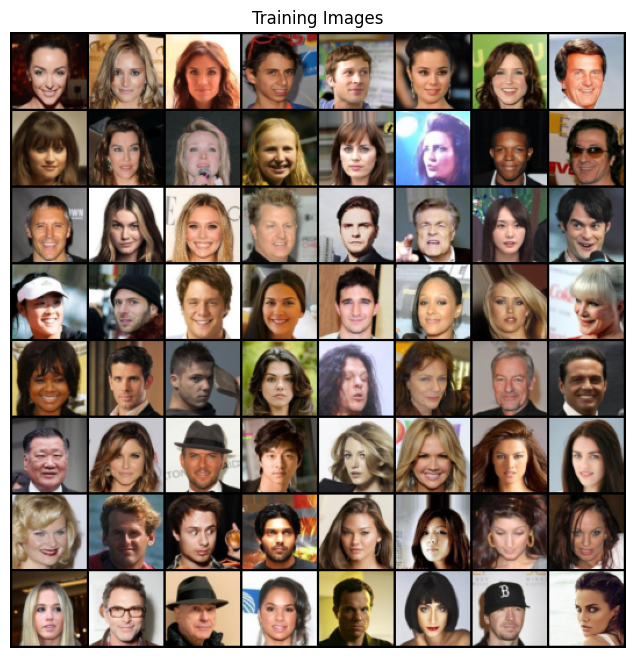

In [ ]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Имплементация

Набор скачали, загрузили, подготовили входные параметры, приступаем к имплементации. Начнем с инициализации весов.

### Инициализация весов

Из статьи берем то что все веса модели должны быть случайно инициализированы из нормального распределения с нулевым средним и стандартным отклонением $= 0.02$. Функция ``weights_init`` принимает инициализированную модель в качестве входных данных и повторно инициализирует все свёрточные и слои пакетной нормализации, чтобы соответствовать этим критериям. Функция применяется к моделям сразу после их инициализации.



In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Генератор


Генератор $G$ отображает вектор скрытого пространства ($z$) в пространство данных. Поскольку наши данные - это изображения, преобразование $z$ в пространство данных в конечном итоге означает создание RGB-изображения того же размера, что и обучающие изображения (т.е. 3x64x64).
На практике это достигается через серию двумерных транспонированных сверточных слоёв с шагом, каждый из которых идет со слоем пакетной нормализации и активацией relu.

Выход генератора подается через функцию tanh для возвращения его в диапазон входных данных $[-1,1]$. Стоит отметить наличие функций пакетной нормализации после слоёв транспонированных сверток, так как это критический вклад статьи о DCGAN. Эти слои помогают потоку градиентов во время обучения. Ниже показано изображение генератора из статьи о DCGAN.

Заметим, как мы обозначенные входные параметры (``nz``, ``ngf``, и
``nc``) используются в архитектуре генератора в коде. ``nz``- это длина входного вектора z , ``ngf`` - размерность карт признаков, and ``nc`` число каналов выходного изображения ( 3 для RGB ). Составляем Генератор:




In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__() # вызова конструктора родительского класса
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            # Входной канал: nz, выходной канал: ngf * 8, ядро свертки размером 4x4, шаг 1, нулевое заполнение, без смещения.
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4`` 8192
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8`` 16384
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16`` 32768
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32`` 65536
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64`` 12288
        )

    def forward(self, input):
        return self.main(input) # прямой проход через все слои

Теперь, создаем экземпляр генератора и инициализируем веса. Смотрим на структуру генератора.



In [ ]:
netG = Generator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))


netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Дискриминатор

$D$ - это сеть бинарной классификации, которая принимает изображение в качестве входных данных и выводит скалярную вероятность того, что входное изображение является реальным (в отличие от поддельного).

Здесь $D$ принимает входное изображение размером 3x64x64, обрабатывает его через серию слоёв Conv2d, BatchNorm2d и LeakyReLU, и выводит окончательную вероятность через активационную функцию Sigmoid. Эта архитектура может быть расширена дополнительными слоями, если это необходимо для решения задачи, но имеет значение использование свёртки с шагом, пакетной нормализации и LeakyReLU. В статье о DCGAN упоминается, что хорошей практикой является использование свёртки с шагом вместо пулинга для понижающей дискретизации, так как это позволяет сети самой учиться функции пулинга.


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Теперь, как и в случае с генератором, создаем дискриминатор, применяем функцию инициализации весов ``weights_init`` и выводим структуру модели.


In [ ]:
netD = Discriminator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))


netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


### Функции потерь и оптимизаторы

 Мы будем использовать ([BCELoss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html#torch.nn.BCELoss)), которая в PyTorch определена как:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Обратите внимание, как эта функция предоставляет расчёт обоих логарифмических компонентов в целевой функции (то есть $\log(D(x))$ и $\log(1-D(G(z)))$). Мы можем указать, какую часть уравнения BCE использовать с входным $y$. Это достигается в цикле обучения, важно понимать, как мы можем выбрать, какой компонент мы хотим рассчитать, просто изменив $y$ (то есть метки GT).

Далее, мы определяем нашу реальную метку как 1, а поддельную как 0. Метки будут использоваться при расчёте потерь $D$ и $G$.

Устанавливаем два отдельных оптимизатора, один для $D$ и один для $G$. Из статьи: оба оптимизатора - Adam с скоростью обучения 0.0002 и Beta1 = 0.5.

Чтобы отслеживать прогресс обучения генератора, мы сгенерируем фиксированный пакет скрытых векторов, взятых из гауссовского распределения (то есть fixed_noise). В цикле обучения мы периодически вводим этот fixed_noise в $G$, чтобы увидеть как из шума формируются изображения.


In [ ]:
# инициализируем лосс
criterion = nn.BCELoss()

# создаем батч векторов скрытого пространства для визуализации прогресса генератора
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1. # чтобы дискриминатор максимизировал вероятность правильной классификации реальных изображений
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


## Обучение

Теперь, когда у нас есть все куски GAN'a, мы можем, наконец, его обучить. Имейте в виду, что обучение GAN является своего рода искусством, т.к. неправильная настройка гиперпараметров может привести к коллапсу с практически нулевой интерпретацией, что пошло не так. Поэтому, в нашей работе мы будем тщательно следовать Алгоритму 1 из оригинальной статьи Гудфеллоу, соблюдая некоторые из подходов, показанных в [ganhacks](https://github.com/soumith/ganhacks). А именно, мы будем "создавать разные мини-батчи для настоящих и поддельных" изображений, также скорректируем целевую функцию G для максимизации $\log(D(G(z)))$.
Обучение разделено на две основные части: Часть 1 занято трейном дискриминатора, а Часть 2, соответсвенно обновляет генератор.


**Часть 1 - Обучение Дискриминатора**


- Напомним, цель обучения дискриминатора - максимизировать вероятность правильной классификации данного входа как реального или поддельного. Согласно Гудфеллоу, мы хотим "update the discriminator by ascending
its stochastic gradient". На практике, мы хотим максимизировать $\log(D(x)) + \log(1-D(G(z)))$. Исходя из предложения раздельных мини-батчей от [ganhacks](https://github.com/soumith/ganhacks), будем рассчитывать это в два шага.

- Сначала мы создадим батч реальных семплов из обучающего набора, проведём через $D$, рассчитаем потери ($\log(D(x))$), затем рассчитаем градиенты в обратном проходе. Во-вторых, мы создадим батч фейковых образцов текущим генератором, проведём этот пакет через $D$, рассчитаем потери ($\log(1-D(G(z)))$) и *накопим* градиенты при обратном проходе. Теперь, когда градиенты накоплены от обоих батчей - полностью реальных и полностью поддельных, делаем шаг оптимизации дискриминатора.

**Часть 2 - Обучение Генератора**

Как указано в оригинальной статье, мы хотим обучить Генератор, минимизируя $\log(1-D(G(z)))$ в попытке генерировать лучшие фейки. Гудфеллоу показал, что это не обеспечивает требуемых градиентов, особенно в начале процесса обучения. В качестве решения, предлагается максимизировать $\log(D(G(z)))$. В коде мы достигаем этого, классифицируя выход Генератора из Части 1 с Дискриминатором, вычисляя потери G *используя реальные метки как GT*, вычисляя градиенты G в обратном проходе, и, наконец, обновляя параметры G с помощью шага оптимизатора. Может показаться контринтуитивным использовать реальные метки как GT-метки для функции потерь, но это позволяет нам использовать часть $\log(x)$ BCELoss (вместо части $\log(1-x)$), что именно то, что нам нужно.

Далее, будем выводить статистику, и в конце каждой эпохи мы будем пропускать наш фиксированный пакет шума через генератор, чтобы визуально отслеживать прогресс обучения G. Сообщаемые статистические данные обучения:

- **Loss_D** - потери дискриминатора, рассчитанные как сумма потерь для всех реальных и всех фейковых батчей ($\log(D(x)) + \log(1 - D(G(z)))$).
- **Loss_G** - потери генератора, рассчитанные как $\log(D(G(z)))$
- **D(x)** - средний выход (по пакету) дискриминатора для всех реальных батчей. Это должно начинаться близко к 1
- **D(G(z))** - усдерненные выходы дискриминатора для всего пакета поддельных образцов. Первое число указывается до обновления D, а второе - после обновления D. Эти числа должны начинаться около 0 и сходиться к 0.5 по мере улучшения работы G.


In [ ]:
# Цикл обучения

# Списки для отслеживания прогресса
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")

for epoch in range(num_epochs):

    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) обновляем дискриминатор: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## обучение на пачке реальных примеров
        netD.zero_grad()

        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой проход
        output = netD(real_cpu).view(-1)
        # Считаем лосс
        errD_real = criterion(output, label)
        # Считаем градиенты
        errD_real.backward()
        D_x = output.mean().item() # средняя вероятность, присвоенная дискриминатором реальным изображениям

        ## обучение с фейковым батчем Train with all-fake batch
        # генерируем батч скрытых векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # генерируем фейковое изображение
        fake = netG(noise)
        label.fill_(fake_label)
        # классифицируем батч при помощи дискриминатора
        output = netD(fake.detach()).view(-1)
        # считаем лосс дискриминатора на пачке фейковых примеров
        errD_fake = criterion(output, label)
        # считаем градиенты для пачки, суммируем с предыдущими градиентами
        errD_fake.backward()
        D_G_z1 = output.mean().item() # Средняя вероятность, присвоенная дискриминатором фейковым изображениям,
                                      # полученным от генератора до обновления параметров генератора
        # считаем ошибку дискриминатора как сумму по всем настоящим и поддельным примерам
        errD = errD_real + errD_fake
        # обновляем веса дискриминатора
        optimizerD.step()

        ############################
        # (2) обновляем генератор: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        # считаем лосс по выходу
        errG = criterion(output, label)
        # считаем градиенты для генератора
        errG.backward()
        D_G_z2 = output.mean().item() # Средняя вероятность, присвоенная дискриминатором фейковым изображениям,
                                      # полученным от генератора после обновления параметров генератора
        # обновляем генератор
        optimizerG.step()

        # выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # сохраняем лоссы для последующей визуализации
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # проверяем как справляется генератор сохраняя выход на fixed_noise
        # сохранение промежуточных результатов
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/20][0/1583]	Loss_D: 2.0296	Loss_G: 3.3192	D(x): 0.3510	D(G(z)): 0.4649 / 0.0514
[0/20][50/1583]	Loss_D: 0.0591	Loss_G: 12.3052	D(x): 0.9628	D(G(z)): 0.0000 / 0.0000
[0/20][100/1583]	Loss_D: 0.5262	Loss_G: 5.0169	D(x): 0.7802	D(G(z)): 0.0310 / 0.0098
[0/20][150/1583]	Loss_D: 0.9839	Loss_G: 10.0788	D(x): 0.9559	D(G(z)): 0.5609 / 0.0003
[0/20][200/1583]	Loss_D: 0.5634	Loss_G: 6.4036	D(x): 0.9530	D(G(z)): 0.3541 / 0.0029
[0/20][250/1583]	Loss_D: 0.6988	Loss_G: 6.4045	D(x): 0.6244	D(G(z)): 0.0067 / 0.0028
[0/20][300/1583]	Loss_D: 2.2952	Loss_G: 3.6335	D(x): 0.2331	D(G(z)): 0.0035 / 0.0453
[0/20][350/1583]	Loss_D: 0.4030	Loss_G: 3.8609	D(x): 0.8204	D(G(z)): 0.1416 / 0.0382
[0/20][400/1583]	Loss_D: 0.5636	Loss_G: 3.7563	D(x): 0.6836	D(G(z)): 0.0336 / 0.0395
[0/20][450/1583]	Loss_D: 0.7261	Loss_G: 5.5793	D(x): 0.8538	D(G(z)): 0.3660 / 0.0077
[0/20][500/1583]	Loss_D: 0.5823	Loss_G: 4.2176	D(x): 0.8337	D(G(z)): 0.2578 / 0.0240
[0/20][550/1583]	Loss_D: 3.3755	Loss_G: 

## Результаты

Посмортим что получилосьв итоге. Здесь мы можем наблюдать три различных результата. Во-первых, то как меняются лоссы Генератора и Дискриминатора со во время обучения. Во-вторых, визуализируем что выдает Генератов при конкретном fixed_noise batch для каждой эпохи. И в-третьих, как выглядит батч с реальными изображениями в сравнении с фейковой.



**Лосс от номера итерации**

Ниже представлены графики компонентов модели относительно итераций.



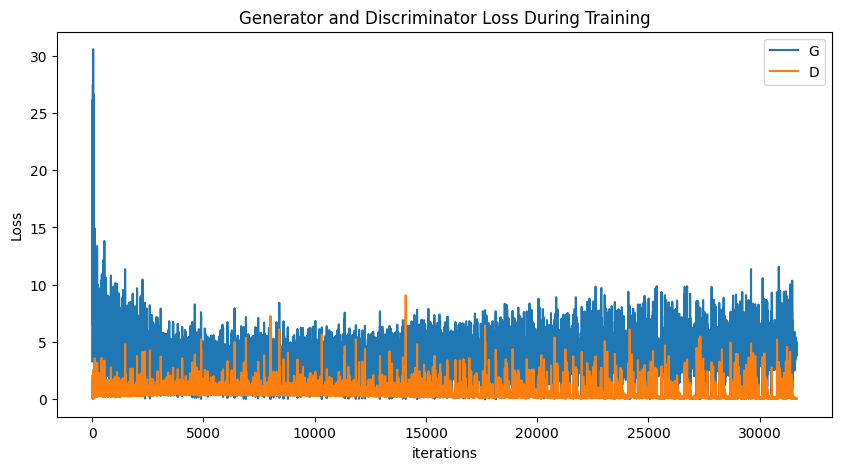

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Визуализация прогресса Генератора**



<figure>
<center>
<img src='https://drive.google.com/uc?export=view&id=1iPUVwXObxAWdTa5E81APU4g1ABHHKnWp' />
</center>
</figure>


Вспоминаем как мы сохранили выход на fixed_noise, батче каждую эпоху обучения. Теперь визуализируем этот результат покадрово.

Жмем плей и смотрим что получилось.



In [ ]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**5

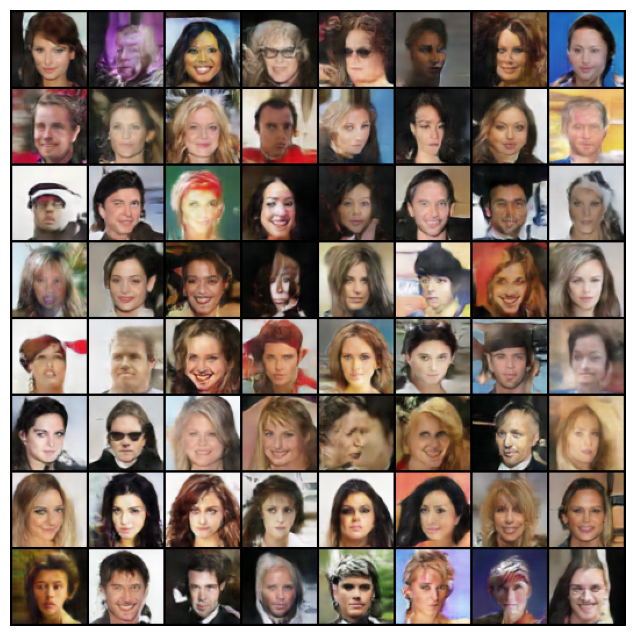

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Реальные и фейковые изображения**


Соответственно здесь смотрим как выглядят в сравнении с реальными изоюражениями наши получившиеся.






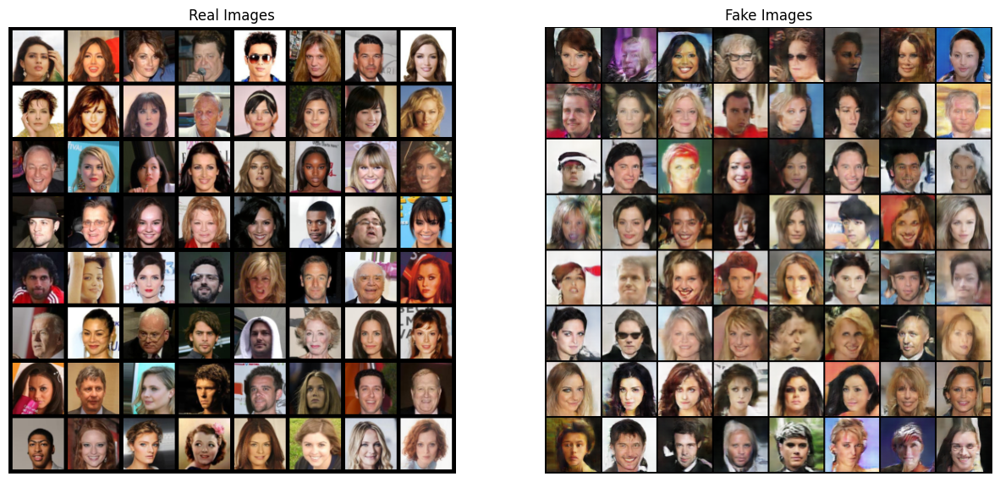

In [ ]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()


## **Что дальше?**

**Настройка параметров обучения**: поэкспериментировать с такими гиперпараметрами, как скорость обучения, размер батча и количество эпох обучения. Как вариант, рассмотреть использование других оптимизаторов. Сравнить результаты.

---

**Изменение топологии**: Скорректируйть/добавить больше слоёв или увеличить количество фильтров в сетях генератора и дискриминатора, для того чтобы увеличить способность модели запоминать сложные паттерны и генерировать более качественные изображения. Как вариант можно использовать более глубокие архитектуры, например ResNet или DenseNet.
